# Basic Technical Analysis Part 1
## Introduction
This information sets out to detail a wide selection of components used in the technical analysis of options. With this there is an explanation of what each component is and how it is used.

In this first part, there is a brief overview of how basic statistical and computational analysis of stock share price can be computed using python. For visualisations I have chosen to plot using the python library plotly (for interaction purposes) but I have also included matplotlib and seaborn as standards. 


# 1. Import Libraries

In [1]:
import yfinance as yf
import pandas as pd
import numpy as np

import datetime
from datetime import date, timedelta

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.style as style
from matplotlib.dates import date2num, DateFormatter, WeekdayLocator,\
    DayLocator, MONDAY
import matplotlib.patches as mpatches

import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go

import seaborn as sns

import mplfinance as mpf
from mplfinance.original_flavor import candlestick_ohlc

from scipy import stats
from scipy.stats import zscore
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import coint

import warnings
warnings.filterwarnings('ignore')

import yfinance as yf

%matplotlib inline

# 2. Dow Jones Index Analysis
## 2.1 Obtaining all Dow Jones Index Tickers

Get all the tickers from the table in this Wikepedia Page
(https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average)


In [2]:
df_dow_jones = pd.read_html("https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average")[1]
df_dow_jones

,Company,Exchange,Symbol,Industry,Date added,Notes,Index weighting
0,3M,NYSE,MMM,Conglomerate,1976-08-09,As Minnesota Mining and Manufacturing,2.41%
1,American Express,NYSE,AXP,Financial services,1982-08-30,NaN,3.02%
2,Amgen,NASDAQ,AMGN,Biopharmaceutical,2020-08-31,NaN,5.48%
3,Apple,NASDAQ,AAPL,Information technology,2015-03-19,NaN,2.84%
4,Boeing,NYSE,BA,Aerospace and defense,1987-03-12,NaN,3.36%
5,Caterpillar,NYSE,CAT,Construction and mining,1991-05-06,NaN,4.52%
6,Chevron,NYSE,CVX,Petroleum industry,2008-02-19,Also 1930-07-18 to 1999-11-01,3.50%
7,Cisco,NASDAQ,CSCO,Information technology,2009-06-08,NaN,0.96%
8,Coca-Cola,NYSE,KO,Drink industry,1987-03-12,Also 1932-05-26 to 1935-11-20,1.22%
9,Disney,NYSE,DIS,Broadcasting and entertainment,1991-05-06,NaN,1.89%


In [3]:
tickers = df_dow_jones['Symbol'].tolist()
tickers


['MMM',
 'AXP',
 'AMGN',
 'AAPL',
 'BA',
 'CAT',
 'CVX',
 'CSCO',
 'KO',
 'DIS',
 'DOW',
 'GS',
 'HD',
 'HON',
 'IBM',
 'INTC',
 'JNJ',
 'JPM',
 'MCD',
 'MRK',
 'MSFT',
 'NKE',
 'PG',
 'CRM',
 'TRV',
 'UNH',
 'VZ',
 'V',
 'WBA',
 'WMT']

In [4]:
dow_jones_stock = yf.download(tickers, start=datetime.datetime(2010,1,1), end=datetime.datetime(2023,1,1), group_by='tickers')
 

[*********************100%***********************]  30 of 30 completed


In [5]:
dow_jones_stock

CSCO                                                        \
                 Open       High        Low      Close  Adj Close    Volume   
Date                                                                          
2010-01-04  24.110001  24.840000  24.010000  24.690001  17.011656  59853700   
2010-01-05  24.600000  24.730000  24.379999  24.580000  16.935862  45124500   
2010-01-06  24.540001  24.740000  24.340000  24.420000  16.825619  35715700   
2010-01-07  24.299999  24.570000  24.170000  24.530001  16.901411  31531200   
2010-01-08  24.379999  24.700001  24.250000  24.660000  16.990982  39115900   
...               ...        ...        ...        ...        ...       ...   
2022-12-23  47.250000  47.490002  47.009998  47.480000  46.067890   9554400   
2022-12-27  47.669998  47.709999  47.220001  47.529999  46.116402  12066200   
2022-12-28  47.689999  47.770000  46.980000  47.070000  45.670082   9847400   
2022-12-29  47.259998  47.740002  47.259998  47.500000  46.087299  11396500   
2022-12-30  47.270000  47.669998  46.950001  47.639999  46.223129  13199800   

                  DIS                                   ...         NKE  \
                 Open       High        Low      Close  ...         Low   
Date                                                    ...               
2010-01-04  32.500000  32.750000  31.870001  32.070000  ...   16.280001   
2010-01-05  32.070000  32.160000  31.700001  31.990000  ...   16.174999   
2010-01-06  31.900000  32.000000  31.680000  31.820000  ...   16.235001   
2010-01-07  31.770000  31.860001  31.540001  31.830000  ...   16.262501   
2010-01-08  31.660000  31.940001  31.530001  31.879999  ...   16.235001   
...               ...        ...        ...        ...  ...         ...   
2022-12-23  86.059998  88.070000  85.769997  88.010002  ...  115.779999   
2022-12-27  87.419998  87.940002  85.959999  86.370003  ...  115.820000   
2022-12-28  86.080002  86.690002  84.070000  84.169998  ...  114.959999   
2022-12-29  85.250000  88.239998  84.970001  87.180000  ...  115.800003   
2022-12-30  85.730003  87.120003  85.230003  86.879997  ...  115.769997   

                                                     VZ                        \
                 Close   Adj Close    Volume       Open       High        Low   
Date                                                                            
2010-01-04   16.337500   13.857415  11972400  31.325493  31.372387  31.034746   
2010-01-05   16.402500   13.912560   6275200  31.297356  31.325493  30.744001   
2010-01-06   16.302500   13.827734  13399200  30.612698  30.706486  29.824869   
2010-01-07   16.462500   13.963442   7187600  30.106237  30.106237  29.571640   
2010-01-08   16.430000   13.935878   7249600  29.693565  29.806112  29.468472   
...                ...         ...       ...        ...        ...        ...   
2022-12-23  116.250000  115.152916   6603700  38.310001  38.540001  37.919998   
2022-12-27  117.559998  116.450554   6661100  38.490002  39.400002  38.320000   
2022-12-28  114.980003  113.894913   5437800  39.189999  39.660000  38.590000   
2022-12-29  117.349998  116.242538   4588600  38.900002  39.529999  38.810001   
2022-12-30  117.010002  115.905746   4355500  39.310001  39.689999  39.070000   

                                            
                Close  Adj Close    Volume  
Date                                        
2010-01-04  31.212946  15.677334  16176648  
2010-01-05  31.269218  15.705596  23722957  
2010-01-06  29.937416  15.253997  37506464  
2010-01-07  29.759218  15.163204  25508242  
2010-01-08  29.777975  15.172758  20658308  
...               ...        ...       ...  
2022-12-23  38.410000  35.781872  16918300  
2022-12-27  39.250000  36.564396  25315900  
2022-12-28  38.810001  36.154507  21793200  
2022-12-29  39.259998  36.573708  17347000  
2022-12-30  39.400002  36.704132  44007200  

[3272 rows x 180 columns]

In [6]:
dow_jones_stock.describe()

CSCO                                                      \
              Open         High          Low        Close    Adj Close   
count  3272.000000  3272.000000  3272.000000  3272.000000  3272.000000   
mean     33.498090    33.808252    33.190923    33.506583    28.000614   
std      12.644248    12.760669    12.525607    12.647221    13.293068   
min      13.930000    14.120000    13.300000    13.730000     9.529290   
25%      22.910000    23.129999    22.629999    22.889999    16.359596   
50%      29.510000    29.780001    29.360000    29.545000    23.055950   
75%      45.000000    45.500000    44.542500    44.967500    40.552789   
max      64.040001    64.290001    63.549999    63.959999    60.169128   

                             DIS                                         ...  \
             Volume         Open         High          Low        Close  ...   
count  3.272000e+03  3272.000000  3272.000000  3272.000000  3272.000000  ...   
mean   3.269060e+07    94.942867    95.776828    94.009771    94.906727  ...   
std    2.570796e+07    40.666535    41.041794    40.193837    40.599067  ...   
min    5.720500e+06    28.730000    29.480000    28.190001    29.000000  ...   
25%    1.876142e+07    57.610000    57.809999    57.340000    57.737500  ...   
50%    2.548035e+07   100.100002   100.924999    99.030003    99.869999  ...   
75%    3.917035e+07   114.605000   115.542500   113.577503   114.542503  ...   
max    5.600402e+08   200.190002   203.020004   195.399994   201.910004  ...   

               NKE                                                   VZ  \
               Low        Close    Adj Close        Volume         Open   
count  3272.000000  3272.000000  3272.000000  3.272000e+03  3272.000000   
mean     63.896996    64.546037    61.106169  8.570902e+06    47.838099   
std      39.620034    40.047540    40.056839  5.080061e+06     8.313585   
min      15.222500    15.325000    12.998622  1.821900e+06    25.407413   
25%      29.440001    29.776250    26.501338  5.718025e+06    44.180000   
50%      54.980000    55.410000    51.386890  7.394500e+06    49.060001   
75%      86.375000    87.289999    83.882940  9.785600e+06    53.869999   
max     175.500000   177.509995   173.653564  8.633960e+07    62.009998   

                                                                         
              High          Low        Close    Adj Close        Volume  
count  3272.000000  3272.000000  3272.000000  3272.000000  3.272000e+03  
mean     48.181639    47.472262    47.837426    34.375427  1.678146e+07  
std       8.370946     8.267545     8.316304    10.289672  1.335949e+07  
min      25.670021    24.844681    25.257351    13.068324  3.375400e+06  
25%      44.470001    43.860001    44.187499    28.686564  1.167172e+07  
50%      49.410000    48.759998    49.105000    34.089088  1.462050e+07  
75%      54.369999    53.452500    53.915000    44.722648  1.924825e+07  
max      62.220001    61.349998    62.070000    52.166176  6.166205e+08  

[8 rows x 180 columns]

In [7]:
dow_jones_stock.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3272 entries, 2010-01-04 to 2022-12-30
Columns: 180 entries, ('CSCO', 'Open') to ('VZ', 'Volume')
dtypes: float64(151), int64(29)
memory usage: 4.5 MB


In [8]:
# The number of rows is an indication of how many trading days are being considered

dow_jones_stock.shape

(3272, 180)

From here on we are only going to conisder the Adjusted Close Price for each company. This is to account for actions such as stock splits and dividends, which gives a reflection with higher accuracy of the true value of the stock. This in turn prevents a clearer more coherent picture of the returns.

In [9]:
adj_close = pd.DataFrame()
for i in tickers:
    adj_close[i] = dow_jones_stock[i]['Adj Close']
    
adj_close

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,55.033230,33.300175,42.146587,6.487534,43.777554,40.733006,45.955864,17.011656,18.645313,27.933918,...,23.522570,13.857415,40.668758,18.705000,35.691948,25.685123,15.677334,19.978863,25.140759,39.871326
2010-01-05,54.688538,33.226940,41.781487,6.498750,45.211349,41.219978,46.281376,16.935862,18.419758,27.864237,...,23.530159,13.912560,40.682072,18.625000,34.846409,25.644394,15.705596,19.749924,24.938559,39.474308
2010-01-06,55.464100,33.764053,41.467514,6.395377,46.582802,41.345203,46.287205,16.825619,18.413223,27.716166,...,23.385759,13.827734,40.489113,18.592501,34.351971,25.896935,15.253997,19.484720,24.749826,39.386070
2010-01-07,55.503895,34.311649,41.087811,6.383557,48.468559,41.512165,46.112808,16.901411,18.367453,27.724873,...,23.142559,13.963442,40.269524,18.510000,34.846409,26.890770,15.163204,19.666061,24.898115,39.408127
2010-01-08,55.894993,34.287151,41.452908,6.425997,48.001015,41.978302,46.194202,16.990982,18.027502,27.768425,...,23.302156,13.935878,40.216290,18.537500,34.796238,26.638239,15.172758,19.720461,24.931812,39.209621
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,115.073784,144.877289,257.084625,131.299820,189.059998,236.272522,172.482574,46.067890,62.360737,88.010002,...,237.112076,115.152916,149.780884,129.440002,186.249542,525.215271,35.781872,204.643112,36.890579,142.135986
2022-12-27,115.150421,144.256454,256.568390,129.477585,189.399994,239.493484,174.650772,46.116402,62.741817,86.370003,...,235.354095,116.450554,151.086151,130.660004,187.232483,525.887512,36.564396,205.100464,36.584988,142.175537
2022-12-28,113.301804,141.911148,254.649384,125.504539,188.380005,235.789886,172.074219,45.670082,62.116455,84.169998,...,232.940567,113.894913,149.133179,128.470001,184.922577,522.388062,36.154507,203.807953,35.887859,139.684174


### Plotting Adjusted Close Price for all stocks

In [10]:
# Assuming 'adj_close' is your Pandas DataFrame
fig = px.line(adj_close, title='Adjusted Close Price for all stocks')
fig.update_xaxes(title='Year')
fig.update_yaxes(title='Adjusted Close Price (dollar)')

# You can adjust the figure size by setting the width and height
fig.update_layout(width=800, height=400)

fig.show()

This plot shows the absolute adjusted close price for each stock. The relative change of a stock price can be of more use when in a trading scenario. This plot shows UNH to have the greatest price. 

### Calculating the minimum and maximum adjusted close price 

In [11]:
adj_close_min_max = adj_close.apply(lambda x: pd.Series([x.min(), x.max()], index=['min', 'max']))
adj_close_min_max

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
min,49.129982,30.069702,35.246288,5.821836,43.777554,35.568455,39.869144,9.529290,16.504198,25.536152,...,17.649071,12.998622,40.056606,15.520000,34.351971,22.803455,13.068324,14.911669,17.909761,35.695942
max,209.277298,193.470047,282.868927,180.190948,430.299988,239.493484,181.433914,60.169128,63.318039,201.910004,...,337.621124,173.653564,158.212952,309.959991,187.232483,547.095337,52.166176,246.838394,73.572899,156.208801


# 2. Data transformation
## 2.1 Consider each stocks' returns since the beginnig of the time frame 

In [12]:
returns_lambda = adj_close.apply(lambda x: x / x[0])
returns_lambda.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2010-01-05,0.993737,0.997801,0.991337,1.001729,1.032752,1.011955,1.007083,0.995545,0.987903,0.997505,...,1.000323,1.003979,1.000327,0.995723,0.976310,0.998414,1.001803,0.988541,0.991957,0.990043
2010-01-06,1.007829,1.013930,0.983888,0.985795,1.064080,1.015030,1.007210,0.989064,0.987552,0.992205,...,0.994184,0.997858,0.995583,0.993986,0.962457,1.008246,0.972997,0.975267,0.984450,0.987829
2010-01-07,1.008552,1.030374,0.974879,0.983973,1.107156,1.019128,1.003415,0.993519,0.985098,0.992516,...,0.983845,1.007651,0.990183,0.989575,0.976310,1.046939,0.967206,0.984343,0.990349,0.988383
2010-01-08,1.015659,1.029639,0.983541,0.990515,1.096475,1.030572,1.005186,0.998785,0.966865,0.994076,...,0.990630,1.005662,0.988874,0.991045,0.974904,1.037108,0.967815,0.987066,0.991689,0.983404


### Plot to show stock returns over the time frame 
This shows how profitable each stock was over a 13 year period

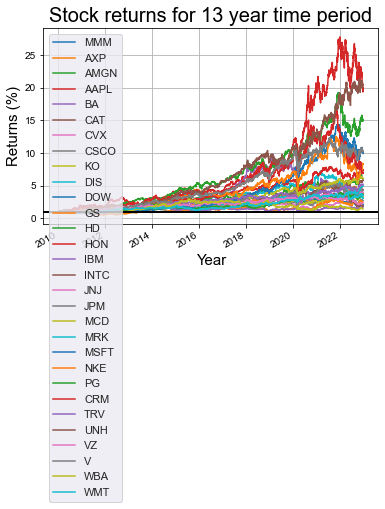

In [13]:
# Plot to show how profitable each stock was throughout the time period

returns_lambda.plot(grid = True).axhline(y = 1, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Stock returns for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Returns (%)', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

This plot is a lot more useful as we can see how profitable each stocj was since the beginning of the time period. 

## 2.2 Percentage Change 
Daily percentage change is another transformation we can use. This can be represented by the formula: $increase_{t}$  = $\frac{price_t - price_{t-1}}{price_t}$ 

In [14]:
# Create dataframe to contain returns for each company's stock to plot the change of each stock per day

returns = pd.DataFrame()
for ticker in tickers:
    returns[ticker] = dow_jones_stock[ticker]['Adj Close'].pct_change() * 100

# Clean up the data by dropping the first value which becomes a 'NaN' as there is no price change from the day before.

returns.dropna(inplace=True)
returns.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.628888,0.947904,0.402873,3.683024,-0.919823,0.789399,0.938315,1.276755,-0.043895,-1.209194,...,2.297465,1.522661,0.756980,2.103848,2.314765,0.606788,1.075089,1.333313,1.290005,0.425763
2019-03-22,-2.361513,-2.110546,-2.704664,-2.070840,-2.825324,-3.200051,-2.200868,-2.224703,0.922876,-0.395726,...,-2.636818,-6.612869,-0.809824,-3.264449,0.394450,-1.956208,2.521873,-1.752233,-1.871063,-0.787380
2019-03-25,-0.708498,-0.383710,-0.058909,-1.209079,2.288960,1.240688,-0.162477,-0.018952,0.217707,-0.406546,...,0.521145,0.170330,0.295082,-0.383898,0.037041,-0.093088,0.535481,-0.026149,-1.153662,-0.111934
2019-03-26,1.983183,0.421883,0.900360,-1.033204,-0.021586,0.350111,1.009055,0.948220,1.325233,2.180163,...,0.212458,1.275353,1.039632,-0.919947,0.022224,-1.405652,0.915439,1.483374,0.372828,0.152816
2019-03-27,-0.038620,-0.474881,-1.035744,0.899417,1.034073,-0.485449,-1.079510,-0.169076,-0.064308,0.127107,...,-0.966833,-0.347812,-0.116494,-2.685068,1.014981,-0.690250,0.412354,-0.695437,0.500631,-1.128988


In [15]:
# Extract the data for the year 2019
returns_2019 = returns.loc['2019-01-01':'2019-12-31']

# Create a line plot using Plotly Express
fig = px.line(returns_2019, x=returns_2019.index, y=returns_2019.columns, title='Stock Returns for 2019')

# Customize the layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Returns (%)',
    title_font=dict(size=20),
    xaxis=dict(title_font=dict(size=15)),
    yaxis=dict(title_font=dict(size=15)),
)

# Add a horizontal line at y=1 for reference
fig.update_layout(
    shapes=[
        dict(
            type="line",
            x0=returns_2019.index.min(),
            x1=returns_2019.index.max(),
            y0=1,
            y1=1,
            line=dict(color="black", width=2)
        )
    ]
)

fig.show()

The percentage returns plot shows the changes for the year 2019 between each day. More advanced methods consider this when modelling stock behaviour on a defined time period.

## 2.3 Log Differences

An alternative approach to modeling stock growth involves utilizing logarithmic differences. By applying the natural logarithm to stock prices, we can more accurately approximate the true daily returns. This concept can be exemplified using the following formula:

$change_{t}$  = $log (price_{t}) - log (price_{t-1})$ 

Employing logarithms or summarizing changes in terms of continuous compounding provides several advantages over analyzing simple percentage changes. For instance, consider a scenario where your investment portfolio increases by 50% (e.g., from £400 to £600) and then decreases by 50% (e.g., from £600 to £300). In this case, calculating the average percentage return (which would be 0%) fails to convey the fact that you actually ended up 50% below your initial investment.

In contrast, if your portfolio increases logarithmically by approximately 0.4055 and then decreases logarithmically by the same amount, you return precisely to your initial investment. The average log return on your portfolio corresponds exactly to the change in log price between the time of purchase and the time of sale, divided by the number of years you held it.

In [17]:
stock_change = adj_close.apply(lambda x: np.log(x) - np.log(x.shift(1))) # shift moves dates back by 1.

stock_change.head()

# Clean up the data by dropping NaNs

stock_change.dropna(inplace=True)
stock_change.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.006269,0.009434,0.004021,0.036168,-0.009241,0.007863,0.009339,0.012687,-0.000439,-0.012166,...,0.022715,0.015112,0.007541,0.020820,0.022884,0.006050,0.010694,0.013245,0.012818,0.004249
2019-03-22,-0.023898,-0.021331,-0.027419,-0.020926,-0.028660,-0.032524,-0.022254,-0.022498,0.009186,-0.003965,...,-0.026722,-0.068417,-0.008131,-0.033189,0.003937,-0.019756,0.024906,-0.017678,-0.018888,-0.007905
2019-03-25,-0.007110,-0.003844,-0.000589,-0.012164,0.022632,0.012331,-0.001626,-0.000190,0.002175,-0.004074,...,0.005198,0.001702,0.002946,-0.003846,0.000370,-0.000931,0.005341,-0.000262,-0.011604,-0.001120
2019-03-26,0.019638,0.004210,0.008963,-0.010386,-0.000216,0.003495,0.010040,0.009438,0.013165,0.021567,...,0.002122,0.012673,0.010343,-0.009242,0.000222,-0.014156,0.009113,0.014725,0.003721,0.001527
2019-03-27,-0.000386,-0.004760,-0.010411,0.008954,0.010288,-0.004866,-0.010854,-0.001692,-0.000643,0.001270,...,-0.009715,-0.003484,-0.001166,-0.027218,0.010099,-0.006926,0.004115,-0.006979,0.004994,-0.011354


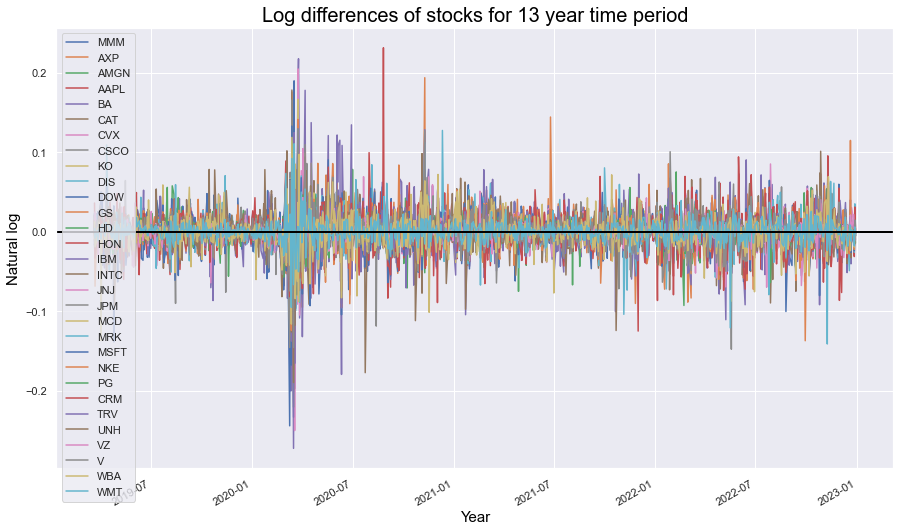

In [18]:
# Plot log differences for 2010-2019

stock_change.plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);

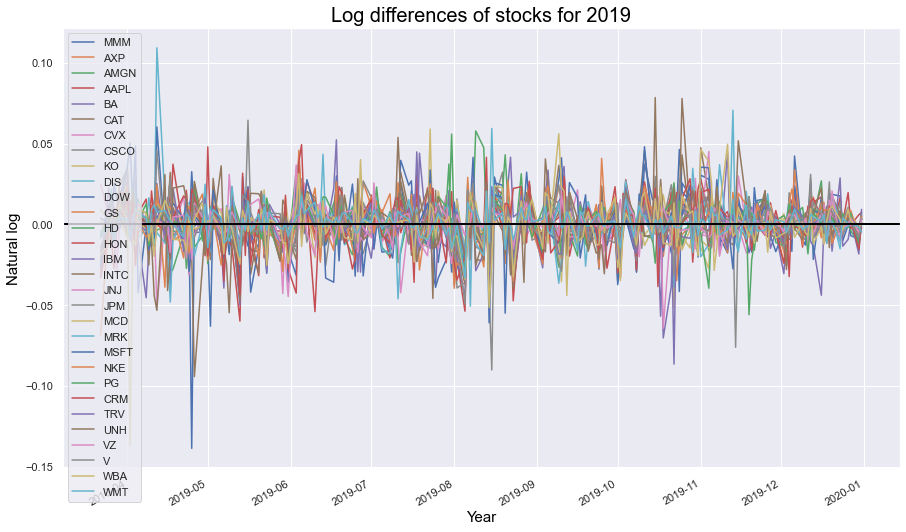

In [19]:
# Plot log differences for 2019

stock_change.loc['2019-01-01':'2019-12-31'][1:].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 2019', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

## 2.4 Annualised Returns
We can calculate the annual percentage rate (APR) by considering annualised returns. 

In [20]:
stock_change_apr = stock_change * 252 * 100    # There are 252 trading days in a year; the 100 converts to percentages
stock_change_apr

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,157.983557,237.746851,101.320045,911.439083,-232.868010,198.147588,235.352901,319.705605,-11.063986,-306.574120,...,572.410656,380.818477,190.040471,524.669825,576.671869,152.448442,269.476363,333.774627,323.002432,107.064499
2019-03-22,-602.240529,-537.550499,-690.962006,-527.330864,-722.233202,-819.597625,-560.813043,-566.955335,231.498124,-99.920886,...,-673.395724,-1724.099286,-204.906516,-836.367977,99.205869,-497.849988,627.630759,-445.477072,-475.974912,-199.205033
2019-03-25,-179.177093,-96.880904,-14.849476,-306.544901,570.315405,310.729820,-40.977515,-4.776472,54.802559,-102.658427,...,130.987412,42.886710,74.251125,-96.928445,9.332617,-23.469156,134.581127,-6.590290,-292.412704,-28.223198
2019-03-26,494.870989,106.090855,225.875305,-261.721844,-5.440256,88.073981,253.007427,237.825699,331.765282,543.497802,...,53.482667,319.356835,260.634772,-232.899603,5.599810,-356.737530,229.641091,371.064881,93.777955,38.480262
2019-03-27,-9.734025,-119.954969,-262.368477,225.639887,259.248323,-122.631069,-273.515464,-42.643316,-16.210952,32.010687,...,-244.827250,-87.801393,-29.373713,-685.887265,254.486004,-174.546092,103.699452,-175.862347,125.844354,-286.123259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,-302.324489,294.820138,-127.624443,-70.611444,108.197344,245.977955,767.278907,85.064197,190.249409,386.635703,...,57.063601,-99.520829,71.096853,48.718260,305.067837,200.949431,65.688804,94.449248,124.254473,50.881347
2022-12-27,16.777204,-108.220158,-50.653398,-352.185974,45.277758,341.216037,314.802893,26.522741,153.526226,-474.013098,...,-187.532195,282.386255,218.654351,236.403349,132.644467,32.233728,545.166385,56.256000,-209.619405,7.011180
2022-12-28,-407.841764,-413.065937,-189.192120,-785.379343,-136.078065,-392.744897,-374.535100,-245.076216,-252.434442,-650.207467,...,-259.757201,-559.201805,-327.864292,-425.958974,-312.828631,-168.250577,-284.088934,-159.308950,-484.820885,-445.498193


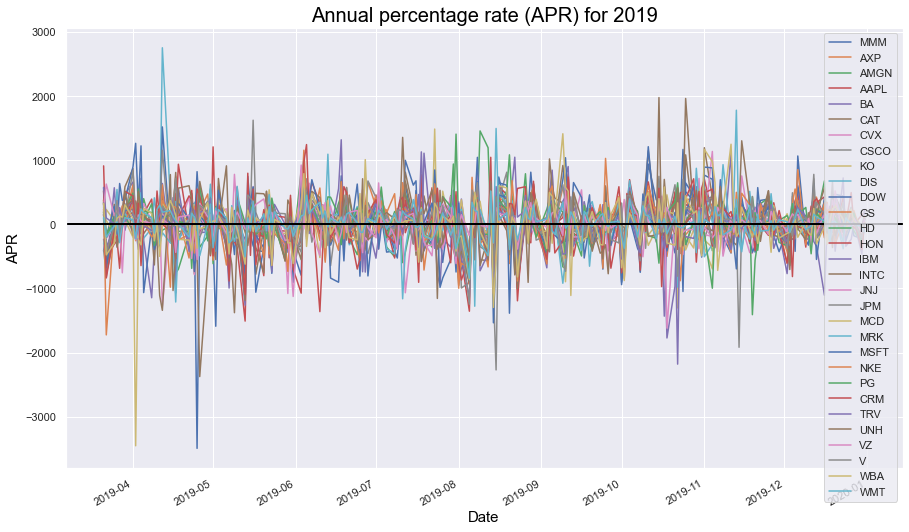

In [21]:
# Plot annualised returns for 2019

stock_change_apr['2019-01-01':'2019-12-31'].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Annual percentage rate (APR) for 2019', color = 'black', fontsize = 20)
plt.xlabel('Date', color = 'black', fontsize = 15)
plt.ylabel('APR', color = 'black', fontsize = 15);

# 3. Calculating Statistical Data for Returns 
## 3.1 Calculating the minimum and maximum returns for 2010-2023

In [22]:
# Date of worst single day returns

returns.idxmin()

MMM    2019-04-25
AXP    2020-03-18
AMGN   2020-03-12
AAPL   2020-03-16
BA     2020-03-16
CAT    2020-03-09
CVX    2020-03-18
CSCO   2022-05-19
KO     2020-03-12
DIS    2022-11-09
DOW    2020-03-09
GS     2020-03-16
HD     2020-03-16
HON    2020-03-12
IBM    2020-03-12
INTC   2020-03-16
JNJ    2020-03-23
JPM    2020-03-16
MCD    2020-03-16
MRK    2021-11-05
MSFT   2020-03-16
NKE    2022-09-30
PG     2020-03-12
CRM    2020-03-16
TRV    2020-03-16
UNH    2020-03-16
VZ     2022-07-22
V      2020-03-16
WBA    2019-04-02
WMT    2022-05-17
dtype: datetime64[ns]

In [23]:
# Date of best single day returns

returns.idxmax()

MMM    2020-03-24
AXP    2020-03-24
AMGN   2020-03-13
AAPL   2020-03-13
BA     2020-03-25
CAT    2020-03-24
CVX    2020-03-24
CSCO   2020-03-13
KO     2020-04-06
DIS    2020-03-24
DOW    2020-03-17
GS     2020-03-13
HD     2020-03-24
HON    2020-03-24
IBM    2020-03-24
INTC   2020-03-13
JNJ    2020-03-30
JPM    2020-03-13
MCD    2020-03-24
MRK    2021-10-01
MSFT   2020-03-13
NKE    2021-06-25
PG     2020-03-13
CRM    2020-08-26
TRV    2020-03-17
UNH    2020-03-24
VZ     2020-03-26
V      2020-03-24
WBA    2020-03-13
WMT    2020-03-17
dtype: datetime64[ns]

There is a common trend amongst the Dow Jones that since they are stocks from the same sector, they have a similarity in there min and max share price. 

## 3.3 Calculating the Mean 
The mean is a statistical indicator that can be used to evaluate the performance f a company's share price over a defined time period. It is the average of the returns, with it also determining the standard deviation and variance which we will touch on later.

In [24]:
returns.mean()

MMM    -0.027745
AXP     0.068697
AMGN    0.058858
AAPL    0.133587
BA     -0.007382
CAT     0.094092
CVX     0.086262
CSCO    0.018697
KO      0.057726
DIS     0.001893
DOW     0.056246
GS      0.092629
HD      0.083617
HON     0.058193
IBM     0.041114
INTC   -0.032310
JNJ     0.045453
JPM     0.062092
MCD     0.058842
MRK     0.060701
MSFT    0.099309
NKE     0.059511
PG      0.061870
CRM     0.010894
TRV     0.065618
UNH     0.104185
VZ     -0.014078
V       0.052936
WBA    -0.014321
WMT     0.055824
dtype: float64

## 3.3 Variance
Variance is a statistical measure that quantifies the extent of deviation from the average or mean in a dataset. It reflects the breadth of the data's range; it is larger when the data covers a wider range and smaller when the range is narrower.

To calculate variance, each data point's difference from the mean is determined, these differences are squared to ensure they are positive, and the sum of these squared differences is divided by the total number of data points in the dataset.

The use of squares in the variance calculation gives more weight to outliers, which are data points that significantly deviate from the mean. This approach also avoids situations where differences above the mean would cancel out differences below it, resulting in a variance value of zero.

Mathematically, variance is represented by the formula σ<sup>2</sup> = $\frac {\sum_{i = 1}^n (x_i - \overline{x})^2}{n}$, where σ<sup>2</sup> denotes the variance, 𝑛 represents the number of data points, 𝑥𝑖 signifies each individual data point, and &xbar; stands for the mean of the dataset.

In [25]:
returns.var()

MMM      3.161756
AXP      6.710326
AMGN     2.797963
AAPL     4.758167
BA      12.281679
CAT      4.470070
CVX      5.964090
CSCO     3.667883
KO       2.083039
DIS      5.095233
DOW      6.750077
GS       4.842338
HD       3.716819
HON      3.445795
IBM      3.209493
INTC     6.141610
JNJ      1.736254
JPM      4.818439
MCD      2.528097
MRK      2.346039
MSFT     4.090279
NKE      4.889823
PG       2.052273
CRM      6.635687
TRV      3.730528
UNH      3.931265
VZ       1.576615
V        3.773202
WBA      4.841843
WMT      2.245822
dtype: float64

## 3.4 Standard Deviation
Standard deviation (represented as σ) plays a crucial role in mathematical statistics and is widely employed beyond its applications in finance. In the realm of statistics, it serves as a fundamental measure of the dispersion or spread of data points within a dataset. This significance extends to various fields, including scientific research, quality control, and data analysis.

Statisticians utilize standard deviation to gain insights into the variability and consistency of data. It assists in identifying patterns, outliers, and trends within a dataset. Moreover, it serves as a key component in hypothesis testing, where it helps assess the degree of confidence in statistical results.

In essence, standard deviation is a versatile statistical tool that transcends its role as a risk measure in finance. It aids in quantifying uncertainty and variability, making it an essential concept in the broader field of mathematical statistics.

In [26]:
returns.std()

MMM     1.778133
AXP     2.590430
AMGN    1.672711
AAPL    2.181322
BA      3.504523
CAT     2.114254
CVX     2.442149
CSCO    1.915172
KO      1.443274
DIS     2.257262
DOW     2.598091
GS      2.200531
HD      1.927905
HON     1.856285
IBM     1.791506
INTC    2.478227
JNJ     1.317670
JPM     2.195094
MCD     1.589999
MRK     1.531678
MSFT    2.022444
NKE     2.211294
PG      1.432576
CRM     2.575983
TRV     1.931457
UNH     1.982742
VZ      1.255633
V       1.942473
WBA     2.200419
WMT     1.498607
dtype: float64

This is only half the picture, however, as, for standard deviation to be used as a measure of risk, we have to assume that the investment performance data follows a normal distribution and has a skewness equal to 0.

## 3.5 Skewness

Financial returns often exhibit either positive or negative skewness, which distorts the appearance of the typically bell-shaped, normally distributed curve. This distortion can impact the accuracy of standard deviation as a risk measure. Skewness, in essence, quantifies the relative magnitude of the two tails of the distribution, shedding light on the distribution's asymmetry.

In [27]:
returns.skew()

MMM    -0.458156
AXP     1.228536
AMGN    0.660652
AAPL    0.035568
BA      0.286379
CAT    -0.252076
CVX    -0.258029
CSCO   -0.434356
KO     -0.578138
DIS     0.461152
DOW    -0.408371
GS      0.202165
HD     -1.104621
HON     0.164608
IBM    -0.550523
INTC   -0.268179
JNJ     0.169699
JPM     0.403119
MCD     0.450684
MRK    -0.155537
MSFT   -0.039001
NKE     0.396942
PG      0.137001
CRM     0.765208
TRV    -1.644740
UNH    -0.055771
VZ      0.066639
V       0.265895
WBA    -0.129856
WMT     0.157129
dtype: float64

This data is not symmetrical as the data falls within a range of -1.7 to 1.25 showing the data is slightly negatively skewed. 

## 3.6 Kurtosis 
Kurtosis is a measure of the combined sizes of the two tails - It does not consider the height of the peak but rather the tail-heaviness of the distribution, or amount of probability in the tails.

In [28]:
returns.kurt()

MMM      8.788528
AXP     16.348908
AMGN     7.174595
AAPL     4.427627
BA      10.535822
CAT      4.191363
CVX     19.938983
CSCO    10.522279
KO       7.381382
DIS      8.227740
DOW     11.988628
GS       9.795354
HD      17.720090
HON     10.158796
IBM      8.738578
INTC    11.417321
JNJ      8.183092
JPM     11.779697
MCD     33.015741
MRK      6.747796
MSFT     7.320499
NKE      8.873869
PG      11.448710
CRM     13.580324
TRV     21.816899
UNH     12.856677
VZ       5.942366
V        8.703920
WBA      5.300387
WMT     13.606214
dtype: float64

A normal distribution will have a kurtosis of 3. However, the pandas kurtosis function makes it a unifrom 0 and so the measures are called excess kurtosis. 

# 4. Visualising Returns
## 4.1 The Pairplot

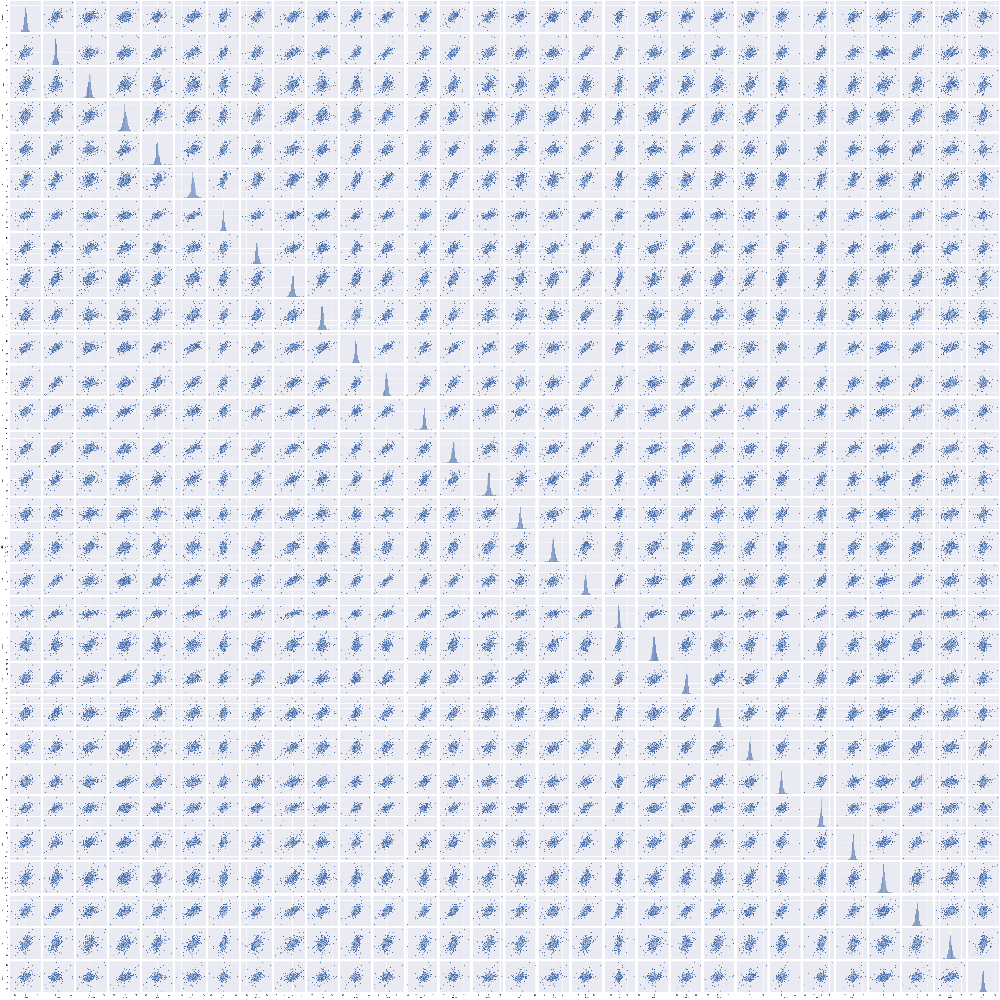

In [29]:
sns.pairplot(returns);

## 4.2 Box Plots
The box and whisker plot is a way of siplaying the distribution of data based on a five criteria (minimum, 1st Quartile (Q1), median, 3rd Quartile (Q3), and maximum). 

In [30]:

# Create a list of box plots for each column in the DataFrame
box_plots = []
for col in returns.columns:
    box_plot = go.Box(y=returns[col], name=col)
    box_plots.append(box_plot)

# Create the layout for the subplot
layout = go.Layout(
    title='Box Plots of Stock Returns',
    xaxis=dict(title='Stocks'),
    yaxis=dict(title='Returns (%)'),
    showlegend=False,
    width=1000,
    height=500
)

# Create the subplot figure
fig = go.Figure(data=box_plots, layout=layout)

# Show the plot
fig.show()

By comparing the differences in the lengths of the boxes (interquartile ranges), we can assess how spread out the data is. When two boxes do not overlap, it indicates distinctions between the two groups being compared. Specifically, we observe that all stocks do not possess this characteristic. 

Additionally, if we analyze the medians of the respective groups and find that one median line lies completely outside of another, it suggests a likely dissimilarity between these two groups. Once again, we can observe that no stocks exhibit distinct characteristics.

The whiskers on the box plot provide insights into the range between the maximum and minimum values, with wider ranges indicating more dispersed or scattered data.

Furthermore, we can use box plots to identify signs of skewness in the data, which may deviate from a normal distribution. Skewed data often result in asymmetric box plots where the median divides the box unevenly. If the longer part of the box lies above the median, we refer to it as positive skewness. Conversely, if the longer part is below or at the median, it signifies negative skewness.

Lastly, any values within the dataset that are significantly different from adjacent values are represented as separate data points on the box plot. This highlights them as potential outliers or extreme observations.

## 4.3 Distribution Plots
Distribution plots depict the variation in the data distribution. Here the distribution of returns is shown by a histogram and a line in combination with it which is the kernel density estimate. 

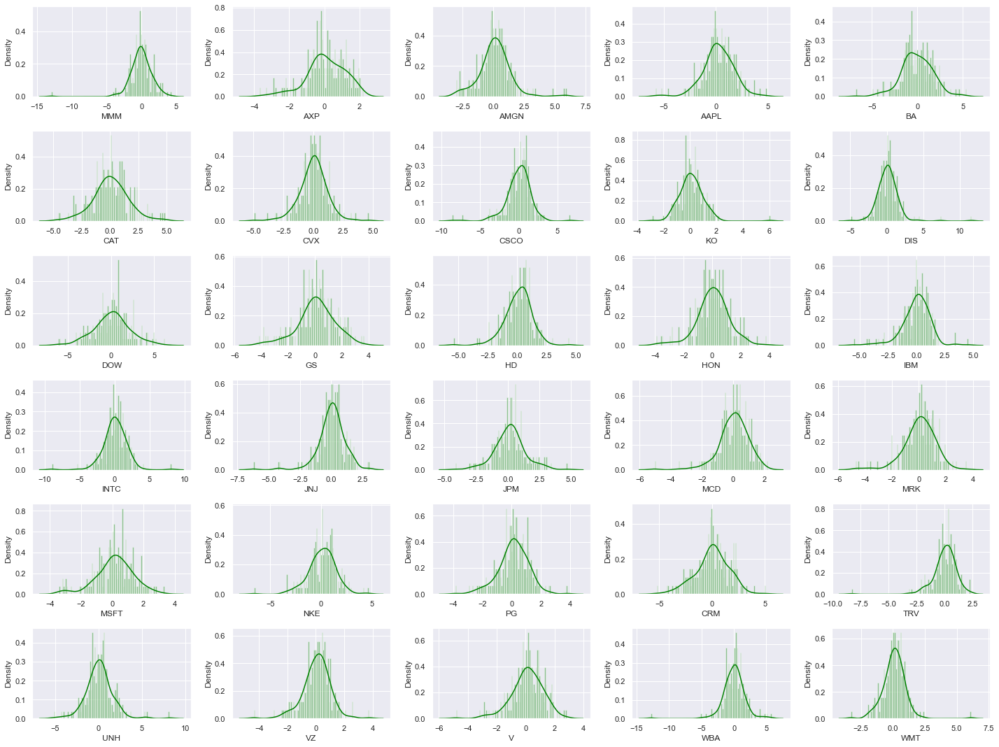

In [31]:
# Create subplots with 5 columns and 6 rows
fig, axs = plt.subplots(ncols=5, nrows=6, figsize=(20, 15))
axs = axs.flatten()

# Loop through tickers and create subplots
for index, ticker in enumerate(tickers):
    if index < len(axs):
        sns.distplot(returns.loc['2019-01-01':'2019-12-31'][ticker], color='green', bins=100, ax=axs[index])

# Remove any remaining empty subplots
for i in range(len(tickers), len(axs)):
    fig.delaxes(axs[i])

# Adjust subplot layout
plt.tight_layout()
plt.show()

## 4.4 Covariance
Covariance reflects the orientation of the linear connection between variables. It quantifies the association between the returns of two stocks, offering insights into whether these returns tend to synchronize or counteract each other.

Investors might also identify stocks that harmonize in terms of price fluctuations. Such a strategy could mitigate overall risk while enhancing the potential return of a portfolio.

In [32]:
returns.cov()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,3.161756,2.513799,1.234330,1.764743,2.519012,2.342083,2.073539,1.863678,1.380710,1.894610,...,1.520799,1.922809,1.153487,1.428486,1.612497,1.567848,0.932940,1.779409,1.999236,0.815484
AXP,2.513799,6.710326,1.544420,2.765930,6.086492,3.442621,4.221939,2.681844,2.204661,3.896949,...,2.701084,3.161504,1.432992,2.748274,3.199209,2.712482,1.259406,3.668398,2.507625,0.904373
AMGN,1.234330,1.544420,2.797963,1.663179,1.268209,1.320504,1.333060,1.524295,1.070479,1.123598,...,1.651196,1.113135,1.240592,1.349573,1.259477,1.702070,0.893801,1.435703,1.421883,0.970934
AAPL,1.764743,2.765930,1.663179,4.758167,3.261921,1.863981,2.003902,2.508206,1.478229,2.398218,...,3.481445,2.722702,1.492124,3.331176,1.595171,2.136203,0.952823,2.657920,1.793958,1.353780
BA,2.519012,6.086492,1.268209,3.261921,12.281679,3.922364,4.810596,2.737567,2.437791,4.345578,...,2.952148,3.668037,1.350437,3.204923,3.361597,2.700574,1.249864,3.574401,2.958111,0.853857
CAT,2.342083,3.442621,1.320504,1.863981,3.922364,4.470070,3.275541,2.042923,1.488800,2.509404,...,1.749600,2.262613,1.028041,1.700423,2.140417,1.766745,1.066840,2.143994,2.330194,0.873643
CVX,2.073539,4.221939,1.333060,2.003902,4.810596,3.275541,5.964090,2.098023,1.709852,2.700666,...,1.992969,2.250094,0.960890,1.962036,2.792852,2.421426,1.136113,2.583973,2.059491,0.787239
CSCO,1.863678,2.681844,1.524295,2.508206,2.737567,2.042923,2.098023,3.667883,1.426116,2.240957,...,2.435266,2.143172,1.490994,2.264152,1.664455,1.864590,1.050267,2.171859,2.002769,1.152162
KO,1.380710,2.204661,1.070479,1.478229,2.437791,1.488800,1.709852,1.426116,2.083039,1.653402,...,1.454292,1.496589,1.357076,1.279512,1.578984,1.487069,0.989530,1.687985,1.375231,0.888182
DIS,1.894610,3.896949,1.123598,2.398218,4.345578,2.509404,2.700666,2.240957,1.653402,5.095233,...,2.422734,2.674708,1.172738,2.587130,1.918139,1.687508,0.935780,2.770746,1.900228,0.918824


## 4.5 Correlation
Correlation gauges both the intensity and orientation of the linear connection between two variables, assessing how closely they move in tandem or opposition to each other. It is derived from covariance and provides a comprehensive measure of the relationship between these variables.

In [33]:
returns.corr()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,1.000000,0.545751,0.414998,0.454985,0.404238,0.622990,0.477503,0.547267,0.538009,0.472035,...,0.422894,0.489019,0.452826,0.311867,0.469515,0.444707,0.417856,0.515177,0.510969,0.306030
AXP,0.545751,1.000000,0.356429,0.489496,0.670450,0.628580,0.667372,0.540573,0.589687,0.666455,...,0.515573,0.551919,0.386149,0.411856,0.639419,0.528115,0.387196,0.729037,0.439932,0.232964
AMGN,0.414998,0.356429,1.000000,0.455825,0.216342,0.373389,0.326330,0.475817,0.443413,0.297583,...,0.488091,0.300940,0.517714,0.313208,0.389838,0.513204,0.425556,0.441864,0.386311,0.387330
AAPL,0.454985,0.489496,0.455825,1.000000,0.426702,0.404170,0.376170,0.600393,0.469541,0.487065,...,0.789157,0.564461,0.477494,0.592836,0.378619,0.493920,0.347880,0.627288,0.373755,0.414134
BA,0.404238,0.670450,0.216342,0.426702,1.000000,0.529373,0.562080,0.407876,0.481969,0.549334,...,0.416517,0.473324,0.268985,0.355014,0.496629,0.388652,0.284035,0.525073,0.383601,0.162581
CAT,0.622990,0.628580,0.373389,0.404170,0.529373,1.000000,0.634386,0.504530,0.487900,0.525813,...,0.409171,0.483957,0.339419,0.312217,0.524151,0.421454,0.401864,0.522049,0.500875,0.275733
CVX,0.477503,0.667372,0.326330,0.376170,0.562080,0.634386,1.000000,0.448570,0.485107,0.489911,...,0.403508,0.416660,0.274653,0.311883,0.592094,0.500072,0.370499,0.544704,0.383250,0.215103
CSCO,0.547267,0.540573,0.475817,0.600393,0.407876,0.504530,0.448570,1.000000,0.515939,0.518375,...,0.628727,0.506061,0.543439,0.458939,0.449966,0.491032,0.436746,0.583806,0.475245,0.401438
KO,0.538009,0.589687,0.443413,0.469541,0.481969,0.487900,0.485107,0.515939,1.000000,0.507514,...,0.498226,0.468929,0.656353,0.344154,0.566427,0.519656,0.546031,0.602095,0.433033,0.410644
DIS,0.472035,0.666455,0.297583,0.487065,0.549334,0.525813,0.489911,0.518375,0.507514,1.000000,...,0.530698,0.535856,0.362661,0.444932,0.439960,0.377049,0.330163,0.631916,0.382576,0.271620


In [34]:
# Create the heatmap
fig = go.Figure(data=go.Heatmap(
                   z=returns.corr(),
                   x=returns.columns,
                   y=returns.columns,
                   colorscale='YlGnBu',
                   zmax=0.8,
                   zmin=-0.8,
                   zmid=0,
                   colorbar=dict(title="Correlation"),
                   hoverongaps=False))

# Customize the layout
fig.update_layout(
    title='Correlation Between Company Returns',
    xaxis_title='Company Tickers',
    yaxis_title='Company Tickers',
    width=700,
    height=700,
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

# Display the heatmap
fig.show()